In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

In [2]:
df = pd.read_csv('csgo_data/model_data.csv')

In [3]:
df.head()

,Player Name,Ping,Kills,Assists,Deaths,MVP,HSP,Score
0,DNB,45,38,4,20,8,42,90
1,link1n,31,22,3,17,5,54,51
2,sn0w,42,14,4,20,0,40,42
3,reedkihaddi,90,13,3,23,0,28,33
4,pEhnol,33,11,4,27,0,54,26


<AxesSubplot:>

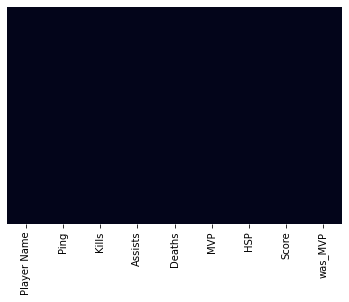

In [43]:
# to check for missing values
sns.heatmap(df.isnull(), yticklabels=False, cbar=False)

In [44]:
# great no missing data!

<AxesSubplot:ylabel='Frequency'>

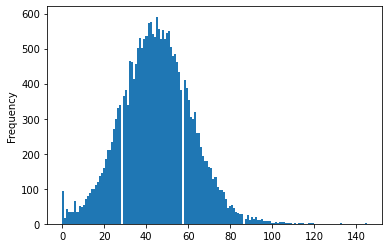

In [45]:
df['Score'].plot.hist(bins=150)

<AxesSubplot:ylabel='Frequency'>

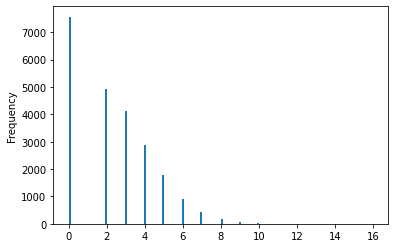

In [46]:
df['MVP'].plot.hist(bins=150)

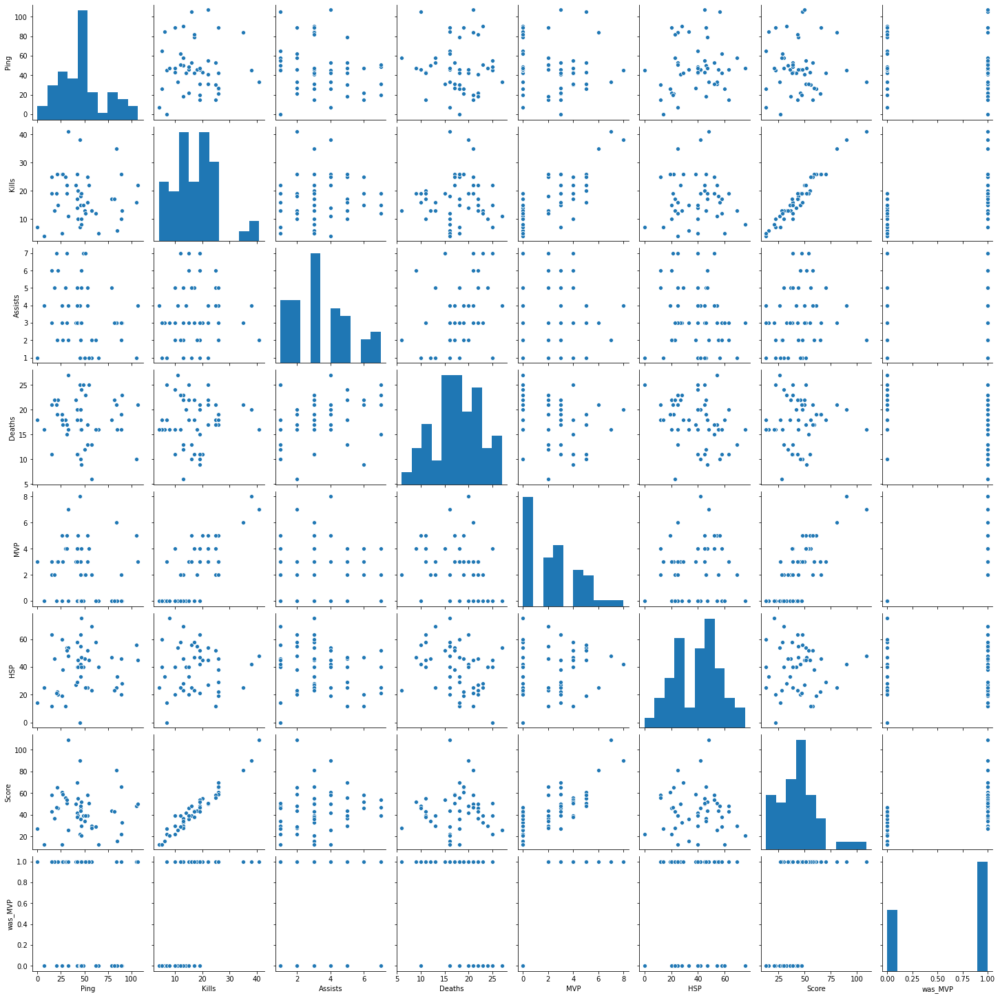

In [47]:
sns.pairplot(df.head(50))
# since we have too much data, it will take a while to make a pairplot. hence we will take the first 50 values

In [38]:
df['MVP'] > 0

0         True
1         True
2        False
3        False
4        False
         ...  
22919     True
22920     True
22921     True
22922     True
22923    False
Name: MVP, Length: 22924, dtype: bool

In [42]:
df['was_MVP'] = df['MVP'].where(df['MVP'] < 1, other = 1)
df.head()

# now we are going to filter out if the player was a MVP or not

,Player Name,Ping,Kills,Assists,Deaths,MVP,HSP,Score,was_MVP
0,DNB,45,38,4,20,8,42,90,1
1,link1n,31,22,3,17,5,54,51,1
2,sn0w,42,14,4,20,0,40,42,0
3,reedkihaddi,90,13,3,23,0,28,33,0
4,pEhnol,33,11,4,27,0,54,26,0


In [54]:
df.drop('MVP', axis = 1, inplace=True)
# now lets drop that column

In [55]:
df.head()

,Player Name,Ping,Kills,Assists,Deaths,HSP,Score,was_MVP
0,DNB,45,38,4,20,42,90,1
1,link1n,31,22,3,17,54,51,1
2,sn0w,42,14,4,20,40,42,0
3,reedkihaddi,90,13,3,23,28,33,0
4,pEhnol,33,11,4,27,54,26,0


In [56]:
# let's drop the player name column too, since we don't actually need it
df.drop('Player Name', axis = 1, inplace=True)

In [57]:
df.head()

,Ping,Kills,Assists,Deaths,HSP,Score,was_MVP
0,45,38,4,20,42,90,1
1,31,22,3,17,54,51,1
2,42,14,4,20,40,42,0
3,90,13,3,23,28,33,0
4,33,11,4,27,54,26,0


In [58]:
# Great! So now the data set is clean (kinda)

In [64]:
# Now we have to standardize the values for the KNN classifier
from sklearn.preprocessing import StandardScaler

In [65]:
scaler = StandardScaler()

In [66]:
scaler.fit(df.drop('was_MVP',axis=1))

StandardScaler()

In [67]:
scaled_features = scaler.transform(df.drop('was_MVP',axis=1))

In [68]:
df_feat = pd.DataFrame(scaled_features,columns=df.columns[:-1])
df_feat.head()

,Ping,Kills,Assists,Deaths,HSP,Score
0,-0.105702,2.789245,0.119354,0.438039,0.528453,2.705132
1,-0.446671,0.573800,-0.337802,-0.228912,1.316192,0.375176
2,-0.178767,-0.533923,0.119354,0.438039,0.397163,-0.162507
3,0.990269,-0.672388,-0.337802,1.104990,-0.390577,-0.700189
4,-0.397961,-0.949319,0.119354,1.994257,1.316192,-1.118386


In [69]:
from sklearn.model_selection import train_test_split

In [70]:
X_train, X_test, y_train, y_test = train_test_split(scaled_features, df['was_MVP'], test_size=0.25)

In [71]:
# Now to use KNN

In [72]:
from sklearn.neighbors import KNeighborsClassifier

In [85]:
knn = KNeighborsClassifier(n_neighbors=1)

In [86]:
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [87]:
pred = knn.predict(X_test)

In [88]:
from sklearn.metrics import classification_report, confusion_matrix

In [89]:
print(confusion_matrix(y_test,pred))

[[1151  748]
 [ 749 3083]]


In [96]:
print('WITH K = 1\n')
print(classification_report(y_test,pred))

WITH K = 1

              precision    recall  f1-score   support

           0       0.61      0.61      0.61      1899
           1       0.80      0.80      0.80      3832

    accuracy                           0.74      5731
   macro avg       0.71      0.71      0.71      5731
weighted avg       0.74      0.74      0.74      5731



In [92]:
# With k=1, the results aren't sp great. now its time to select an efficient k value using the elbow method

In [93]:
error_rate = []

# Will take some time
for i in range(1,40):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

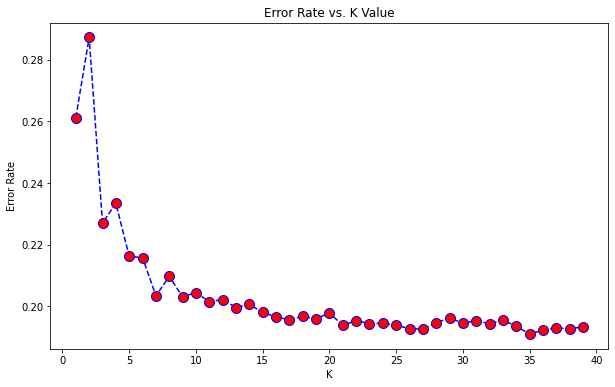

In [94]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [95]:
# from the looks of it, the best k value is around 35-ish...
# So now its time to retrain the model

In [97]:
# now with k=35
knn = KNeighborsClassifier(n_neighbors = 35)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K = 35\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K = 35

[[1208  691]
 [ 404 3428]]


              precision    recall  f1-score   support

           0       0.75      0.64      0.69      1899
           1       0.83      0.89      0.86      3832

    accuracy                           0.81      5731
   macro avg       0.79      0.77      0.78      5731
weighted avg       0.80      0.81      0.80      5731



In [99]:
# now the results are kinda better.
# Since the data is from a game and the decision of choosing an MVP for a round is pretty inconsistent, this is a pretty good accuracy. If you have played CSGO, you would know that MVP isn't completely dependent on the kills and assists, as you have to plant or defuse the bomb too. SO anyway, this is a good way i could try to fit a KNN model to some game data!
